<a name="top"> <h1>01. EDA</h1> <a>

<p>Yelp Dataset- Stars Prediction<br />
<strong>Aprendizaje Autom&aacute;tico</strong><br />
<strong>Master Universitario en Ciencia de Datos</strong></p>

<p>&nbsp;</p>

<p style="text-align:right">Antonio Nogués Podadera (<em>antonio.nogues@cunef.edu</em>)</p>
<p style="text-align:right">V&iacute;ctor Viloria V&aacute;zquez (<em>victor.viloria@cunef.edu</em>)</p>


<hr style="border:1px solid gray">

### Estructura

[0. Introducción](#introduccion) 

   - Objetivo de negocio

[1. Librerias utlizadas y entorno](#librerias) 

   - Carga de librerias.
   - Carga de funciones.

[2. Tratamiento de datos](#tratamiento) 

   - Carga de datos
   - Unión de Dataframes
   - Análisis de tipos de datos
   - Diccionario de datos
   - Variable Objetivos


[3. Análisis EDA](#analisis) 

   - Nombramiento de datos y aspéctos éticos 
   - Análisis de valores duplicados
   - Análisis de valores nulos
   - Análisis de variables categóricas y numéricas
   - Análisis de Outliers


[4. Exportación del dataset transformado](#exportacion)

<hr style="border:1px solid gray">

# <a name="introduccion"> 0. Introducción <a> 

Esta práctica consiste en la exploración e investigación de casos de negocio aplicables al dataset `yelp_academic_dataset`. Para ello deberemos aplicar todo lo aprendido durante el curso, además de trabajar con visualizaciones geográficas, gráfos y procesamiento de archivos de gran capacidad y de tipo JSON (Previamente realizado en `00_Preprocessing`).

**En este notebook unicamente se explicará el objetivo de negocio y se realizará un análisis descriptivo de los datos.**

## 0.1 Objetivo de negocio

**El objetivo de negocio es a través de la información registrada por los negocios en la plataforma y sus características, poder predecir si el promedio de puntuación que alcanzarán por parte de los usuarios será alto o bajo.** 

Para ello trabajaremos con 2 ficheros: `business_df` y `categories_df` además nos centraremos principalmente en los locales con **categoría 'Restaurante'**.

**Nuestro objetivo se caracteriza por ser un problema de clasificación supervisado.**

<hr style="border:1px solid gray">


# <a name="librerias"> 1. Librerias utilizadas y entorno. <a>


## 1.1. Carga de librerias

Improtamos las librerias a utilizar:

In [32]:
# Ignore warnings

import warnings
warnings.filterwarnings("ignore")

# General.

import pandas as pd
import numpy as np

# Visualization.

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import folium


# Train, Validation, Test split.

from sklearn.model_selection import train_test_split 


## 1.2. Carga de funciones

Importamos las funciones que vamos a utilizar durante el EDA.

In [2]:
# Importing the functions:

from aux_functions import *
from transformations import count_checkins

# <a name="tratamiento"> 2. Tratamiento de datos <a>

En este punto se procederá a cargar los datos previamente procesados en `0_DataPreprocessing`, se unificarán los datos que sean interesantes para nuestro caso de negocio y se analizarán los formatos de las variables.

## 2.1. Carga de datos

Lectura del archivo `business_df` y `categories_df` generados en `0_DataPreprocessing`. Nos serán necesarios para filtrar la variable `business_id` por categorías relacionadas con la hostelería y obtener sus detalles/ atributos. 

In [3]:
# Load the data business_df.parquet

business_df = pd.read_parquet('../data/processed/business_df.parquet')

# Load the data review_df.parquet

categories_df = pd.read_parquet('../data/processed/categories_df.parquet')

En `checkin_df` disponemos de las fechas en las que los usuarios han publicado si han estado en el local, puede que nos resulte útil, por lo que cargaremos el archivo y extraeremos el total de visitas en función de la variable `business_id`.

In [4]:
# Load the data checkin_df.parquet.

checkin_df = pd.read_parquet('../data/raw/yelp_academic_dataset_checkin.parquet')

# Count of checkins per business_id.

checkin_df['total_checkins'] = checkin_df['date'].apply(count_checkins)

Procedemos a analizar la estructura inicial de los dataframes `business_df`, `categories_df` y `checkin_df`.

In [5]:
# Verification of the shape for 'business_df'

print("business_df contiene " + str(business_df.shape[0]) +" filas y " + str(business_df.shape[1]) + " columnas")

# Verification of the shape for 'categories_df'

print("categories_df contiene " + str(categories_df.shape[0]) +" filas y " + str(categories_df.shape[1]) + " columnas")

# Verification of the shape for 'checkin_df'

print("checkin_df contiene " + str(checkin_df.shape[0]) +" filas y " + str(checkin_df.shape[1]) + " columnas")

business_df contiene 150346 filas y 99 columnas
categories_df contiene 150346 filas y 1313 columnas
checkin_df contiene 131930 filas y 3 columnas


## 2.2. Unión de dataframes

En este apartado se procederá a fusionar los datos que resulten útiles para el caso de negocio explicado anteriormente. En este caso, obtener una predicción de si el negocio va a tener una puntuación alta o no. 

Se procede a incluir en `business_df` la variable `total_checkins`. Dado que puede resultar interesante saber el nº de visitas publicadas en la platadorma para calcular la predicción.

In [6]:
# Merge the checkin_df with the business_df by business_id.

business_df = pd.merge(business_df, checkin_df[['business_id', 'total_checkins']], on='business_id', how='inner')

# Display the first 5 rows of the business_df

business_df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,...,attributes_DietaryRestrictions_soy-free,attributes_DietaryRestrictions_vegetarian,total_hours_Monday,total_hours_Tuesday,total_hours_Wednesday,total_hours_Thursday,total_hours_Friday,total_hours_Saturday,total_hours_Sunday,total_checkins
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.4266787,-119.7111968,5.0,7,...,nan,nan,nan,nan,nan,nan,nan,nan,nan,1
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,...,nan,nan,0.0,10.5,10.5,10.5,10.5,6.0,nan,15
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,...,nan,nan,14.0,14.0,14.0,14.0,15.0,15.0,14.0,401
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.9555052,-75.1555641,4.0,80,...,nan,nan,13.0,13.0,13.0,13.0,14.0,14.0,14.0,335
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.3381827,-75.4716585,4.5,13,...,nan,nan,nan,nan,8.0,6.0,10.0,10.0,6.0,14


Una vez definido el problema procederemos a quedarnos con los negocios que estén incluidos en la categoría `Restaurants` y que sigan abiertos. Una vez realizado el filtrado deshecharemos aquellas variables irrelevantes para el analisis. Para ello previamente deberemos realizar alguna trasnformación de formato de variables

Se puede observar que las variables referentes al número de horas que está abierto el establecimiento por días de la semana (`total_hours_*`) son de tipo objeto por lo que se procederá a transformarlas a tipo numérico.

El número de reviews que tiene el establecimiento (`review_count`) , `total_checkins` y `Restaurants` serán transformadas a tipo numérico también.

In [7]:
# Convert the type of data for each variable from 'object' to 'float64'.

business_df['total_hours_Monday'] = business_df['total_hours_Monday'].astype('float64')
business_df['total_hours_Tuesday'] = business_df['total_hours_Tuesday'].astype('float64')
business_df['total_hours_Wednesday'] = business_df['total_hours_Wednesday'].astype('float64')
business_df['total_hours_Thursday'] = business_df['total_hours_Thursday'].astype('float64')
business_df['total_hours_Friday'] = business_df['total_hours_Friday'].astype('float64')
business_df['total_hours_Saturday'] = business_df['total_hours_Saturday'].astype('float64')
business_df['total_hours_Sunday'] = business_df['total_hours_Sunday'].astype('float64')


# Convert 'review_count' and 'total_checkins' from 'object' to 'int64'.

business_df['review_count'] = business_df['review_count'].astype('int64')
business_df['total_checkins'] = business_df['total_checkins'].astype('int64')
business_df['is_open'] = business_df['is_open'].astype('int64')


# From the 'categories_df' dataframe, convert the 'Restaurants' variable from 'object' to 'int64'.

categories_df['Restaurants'] = categories_df['Restaurants'].astype('int64')


Procedemos a unir los dataframes en `restaurants_df`.

In [8]:
# Extract the business_id of the Restaurants in the 'categories_df' dataframe.

ids = categories_df[categories_df['Restaurants'] == 1]['business_id'].tolist()

# Join the variables of business_df with the 'ids' list.

restaurants_df = business_df[business_df['business_id'].isin(ids)].reset_index(drop=True)

# Drop the rows with 'is_open' = 0.

restaurants_df = restaurants_df[restaurants_df['is_open'] == 1].reset_index(drop=True)

# Convert the type of data for each variable since variable 8 to from 'object' to 'int64'. If an error occurs, skip to the next variable.

for i in range(6, len(restaurants_df.columns)):
    try:
        restaurants_df.iloc[:,i] = restaurants_df.iloc[:,i].astype('float64')
    except:
        continue


**Mostramos como nos queda el dataframe a analizar: `restaurants_df`**

In [9]:
# Display the first 5 rows of the restaurants_df.

restaurants_df.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,...,attributes_DietaryRestrictions_soy-free,attributes_DietaryRestrictions_vegetarian,total_hours_Monday,total_hours_Tuesday,total_hours_Wednesday,total_hours_Thursday,total_hours_Friday,total_hours_Saturday,total_hours_Sunday,total_checkins
0,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80.0,...,NaN,NaN,13.0,13.0,13.0,13.0,14.0,14.0,14.0,335.0
1,CF33F8-E6oudUQ46HnavjQ,Sonic Drive-In,615 S Main St,Ashland City,TN,37015,36.269593,-87.058943,2.0,6.0,...,NaN,NaN,0.0,16.0,16.0,16.0,15.0,13.0,14.0,22.0
2,bBDDEgkFA1Otx9Lfe7BZUQ,Sonic Drive-In,2312 Dickerson Pike,Nashville,TN,37207,36.208102,-86.768170,1.5,10.0,...,NaN,NaN,0.0,15.0,15.0,10.0,10.0,11.0,15.0,21.0
3,eEOYSgkmpB90uNA7lDOMRA,Vietnamese Food Truck,,Tampa Bay,FL,33602,27.955269,-82.456320,4.0,10.0,...,NaN,NaN,3.0,3.0,3.0,3.0,3.0,5.0,3.0,4.0
4,il_Ro8jwPlHresjw9EGmBg,Denny's,8901 US 31 S,Indianapolis,IN,46227,39.637133,-86.127217,2.5,28.0,...,NaN,NaN,16.0,16.0,16.0,16.0,16.0,16.0,16.0,54.0


## 2.3. Análisis de tipos de datos

En este apartado procederemos a analizar el tipo de dato inicial que contiene cada variable.

In [10]:
# Verification of the different types of data in the 'restaurants_df'.

print(restaurants_df.dtypes.sort_values().to_frame('feature_type').groupby(by = 'feature_type').size().to_frame('count').reset_index())

# Print the type of data for each variable.

restaurants_df.dtypes 

  feature_type  count
0      float64     87
1       object     13


business_id              object
name                     object
address                  object
city                     object
state                    object
                         ...   
total_hours_Thursday    float64
total_hours_Friday      float64
total_hours_Saturday    float64
total_hours_Sunday      float64
total_checkins          float64
Length: 100, dtype: object

Dado que durante el preprocesado guardamos los ficheros a tipo parquet, gran parte de ellos pasaron a ser de tipo object. Por lo que anteriormente realizamos la conversión numérica a la selección de variables con el objetivo de que puedan ser analizadas fácilmente. 

## 2.4. Diccionario de datos

Para un mayor entendimiento de los datos se ha elaborado un diccionario de datos. En él encontramos información detallada de cada una de las variables: Nombre, descripción, tipo de variable, tipo de dato y valores. Al ser los archivos originales de tipo JSON tuvieron que pasar por un preprocesado, de manera que nuestro dataset `restaurants_df` no tiene nada que ver con el original, por lo que hemos generado un nuevo diccionario procesado.

En cuanto al contenido de los datos, disponemos de una selección de transacciones realizadas y nos encontramos con 100 variables que proveen información acerca de los diferentes restaurantes, como localización, atributos, visitas, valoraciones...  

Nos encontramos con dos tipos de variables:

- **Variables Categóricas** . El significado de cada valor se puede encontrar en `Dictionary_processed.md`.
- **Variables Numéricas** .

Analizamos el **nº de valores distintos que adquiere cada variable**, para tenerlo en cuenta en el diccionario.

In [11]:
uniqueValues = restaurants_df.nunique()
print('Número de valores distintos en cada variable :')
print(uniqueValues)

Número de valores distintos en cada variable :
business_id             34516
name                    23102
address                 32340
city                      839
state                      16
                        ...  
total_hours_Thursday       90
total_hours_Friday         89
total_hours_Saturday       96
total_hours_Sunday         88
total_checkins           1871
Length: 100, dtype: int64


## 2.5. Variable Objetivo

La variable objetivo de este estudio es predecir si un restaurante va adquirir una puntuacion alta (4-5 estrellas) en función de sus atributos e información registrada en la plataforma Yelp. Para ello deberemos convertir la variable `stars` en binaria, agrupando las puntuaciones 4,5 en 1 y menores de 4 en 0. Observamos la distribución original:

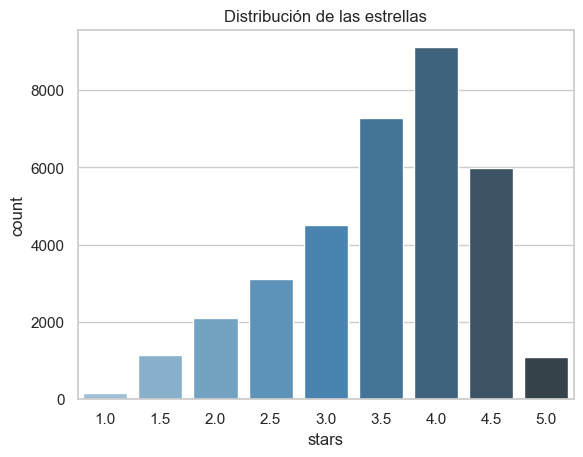

In [12]:
# Graphic of the distribution of the variable 'stars'.

sns.set(style="whitegrid")
ax = sns.countplot(x="stars", data=restaurants_df, palette="Blues_d")
plt.title('Distribución de las estrellas')

plt.rcParams['figure.figsize'] = (20, 5)

plt.show()


Realizamos la conversión de los valores y representamos la nueva gráfica.

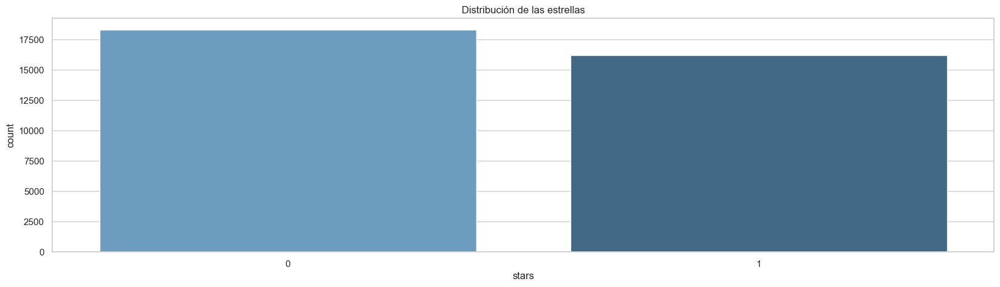

In [13]:
# Replace the stars values as a binary problem:

restaurants_df['stars'] = restaurants_df['stars'].apply(lambda x: 1 if x >= 4 else 0)

# Plot the new graph.

sns.set(style="whitegrid")
ax = sns.countplot(x="stars", data=restaurants_df, palette="Blues_d")
plt.title('Distribución de las estrellas')

plt.rcParams['figure.figsize'] = (20, 5)

plt.show()



Observamos como la variable objetivo tras la converssión está prácticamente balanceada.

# <a name="analisis"> 3. Análisis EDA <a>

En este apartado **se realizará el estudio exploratorio de los datos pertenecientes al dataset  `restaurants_df`**. Para este análisis, nos centraremos en todo el dataset, de manera que en caso de realizar una transformación se aplique a todo el conjunto.

## 3.1. Nombramiento de datos y aspéctos éticos

En el dataset `restaurants_df` las variables tienen un correcto nombramiento, permiten diferenciarse facilmente, por lo que se puede trabajar facilmente con ellas. Esto se debe principalmente al proceso de preprocesamiento realizado en el documento `00_Preprocessing` donde diferenciamoes entre las variables atributos, categorías y subgrupos. **Es por ello que no realizaremos ninguna modificación en cuanto a nombre de variables**

Respecto a los aspectos éticos, **todas las variables cumplen aspéctos éticos y no son sensibles, por lo que en este aspecto tampoco se eliminarán variables**. Tal y como indica la Comisión Europea en [este artículo](https://commission.europa.eu/law/law-topic/data-protection/reform/rules-business-and-organisations/legal-grounds-processing-data/sensitive-data/what-personal-data-considered-sensitive_en)

Sin embargo, **existen variables que para la categoría de restaurantes nos van a ser irrelevantes, como los atributos relacionados con peluquería (`attributes_HairSpecializesIn_*`)**. 

Además, **se procede a eliminar las variables referentes a la localización puesto que la latitud y la longitud ya nos aporta información suficiente. Por ello se ha prescindido de las variables `address` y `postal_code`.** 



In [14]:

# Drop variables that are not relevant for the restarutants. Those ones that starts by 'attributes_HairSpecializesIn_'.

restaurants_df = restaurants_df.drop([col for col in restaurants_df.columns if col.startswith('attributes_HairSpecializesIn')], axis=1)

# Drop the variables of  'adress', 'postal_code'.

restaurants_df = restaurants_df.drop(['address', 'postal_code'], axis=1)

Comprobamos que se haya eliminado la variable observando la nueva estructura del dataframe `restaurants_df`:

In [15]:
# Print the current shape of 'restaurants_df'.

print("El DF restaurants_df contiene " + str(restaurants_df.shape[0]) +" filas y " + str(restaurants_df.shape[1]) + " columnas")

El DF restaurants_df contiene 34516 filas y 90 columnas


## 3.2 Análisis de valores duplicados

Realizamos el análisis de valores duplicados, comprobando si existe alguna fila duplicada. En caso positivo nos mostrará el nº.

In [16]:
# Save in 'restaurants_duplicated' the duplicated rows.

restaurants_duplicated = restaurants_df[restaurants_df.duplicated()]

# Print the number of duplicated rows in 'restaurants_duplicated' 

print('Hay un número de '+str(len(restaurants_duplicated))+ " valores duplicados en el dataset restaurants_df")

Hay un número de 0 valores duplicados en el dataset restaurants_df


**No hay valores duplicados, por lo que podemos continuar con el análisis**

## 3.3. Análisis de valores nulos

### 3.3.1 Análisis de valores nulos por filas y columnas

En este apartado procederemos a analizar el nº de valores nulos de cada variable por columnas y filas y entender su significado.

In [17]:
# Sum the number of nulls values of the different columns and rows, then the data is sorted from highest to lowest.

pd_series_null_columns = restaurants_df.isnull().sum().sort_values(ascending=False)
pd_series_null_rows = restaurants_df.isnull().sum(axis=1).sort_values(ascending=False)

# Create two dataframes showing the null values and proportion of business_df in rows and columns.

pd_null_columnas = pd.DataFrame(pd_series_null_columns, columns=['Valores nulos en columnas'])     
pd_null_filas = pd.DataFrame(pd_series_null_rows, columns=['Valores nulos en filas'])  
pd_null_columnas['porcentaje'] = pd_null_columnas['Valores nulos en columnas']/business_df.shape[0]*100 
pd_null_filas['porcentaje_filas']= pd_null_filas['Valores nulos en filas']/business_df.shape[1]

**Análizamos el número de valores nulos en filas y su proporción:**

In [18]:
# Show the number of null values in the rows and the proportion.

(pd_null_filas[pd_null_filas['Valores nulos en filas']>0].value_counts()).sort_values(ascending=False)

Valores nulos en filas  porcentaje_filas
35                      0.35                2493
34                      0.34                2163
36                      0.36                1993
33                      0.33                1432
37                      0.37                1420
                                            ... 
12                      0.12                  21
11                      0.11                   8
10                      0.10                   3
8                       0.08                   1
6                       0.06                   1
Length: 66, dtype: int64

Observamos como en el **6% de las filas hay al menos 6 variables con valores nulos**. Aumentando gradualmente hasta el máximo de nulos por filas, siendo 35, con una proporción del 35%. 

**Mostramos las variables con valores nulos en columnas y proporción:**

In [19]:
# Show the variables with more than 0 null values in columns.

pd_null_columnas[pd_null_columnas['Valores nulos en columnas']>0]

,Valores nulos en columnas,porcentaje
attributes_AcceptsInsurance,34501,26.150989
attributes_RestaurantsCounterService,34500,26.150231
attributes_DietaryRestrictions_dairy-free,34498,26.148715
attributes_DietaryRestrictions_kosher,34498,26.148715
attributes_DietaryRestrictions_vegan,34498,26.148715
...,...,...
total_hours_Saturday,4041,3.062988
total_hours_Wednesday,4023,3.049344
total_hours_Thursday,3550,2.690821
total_hours_Friday,3385,2.565755


**Observamos como en las columnas de los atributos puede llegar a haber hasta un 26% de valores nulos. Principalmente se puede deber a que el restaurante no ha indicado si dispone o no de ese atributo, por lo que a la hora de la realización de los modelos decidiremos que imputación realizar a estos valores.**

## 3.4.  Análisis de variables categóricas y numéricas

### 3.4.1 Análisis de los valores de las Variables categóricas

Las variables categóricas han de ser tratadas posteriormente para introducirlas en un modelo de Machine Learning. Para ello, se procederá a realizar **un análisis de cada una de ellas para ver si es necesario realizar algún tipo de transformación y determinar como se comportan frente a la variable objetivo**. 

Crearemos una lista con las variables categóricas, con para mostrar sus diferentes valores.

In [20]:
# Create a DF with all the categorical variables.

categorical_variables = restaurants_df[[col for col in restaurants_df.columns if not col.startswith('total_') and not col.startswith('review_count')]]

Mostramos los diferentes valores existentes para cada variable y número de distintos.

In [21]:
# Create a DF with categorical_variables as rows and the number of unique values and distinct values as columns.

categorical_variables_df = pd.DataFrame(columns=['unique_values', 'distinct_values'])

for i in categorical_variables:
    categorical_variables_df.loc[i, 'unique_values'] = restaurants_df[i].nunique()
    categorical_variables_df.loc[i, 'distinct_values'] = restaurants_df[i].unique().tolist()

# Display the first 5 rows of the categorical_variables_df.

categorical_variables_df

,unique_values,distinct_values
business_id,34516,"[MTSW4McQd7CbVtyjqoe9mw, CF33F8-E6oudUQ46Hnavj..."
name,23102,"[St Honore Pastries, Sonic Drive-In, Vietnames..."
city,839,"[Philadelphia, Ashland City, Nashville, Tampa ..."
state,16,"[PA, TN, FL, IN, NV, IL, NJ, CA, LA, DE, MO, A..."
latitude,33564,"[39.9555052, 36.269593, 36.2081024, 27.9552692..."
...,...,...
attributes_DietaryRestrictions_vegan,2,"[nan, 1.0, 0.0]"
attributes_DietaryRestrictions_kosher,1,"[nan, 0.0]"
attributes_DietaryRestrictions_halal,2,"[nan, 0.0, 1.0]"
attributes_DietaryRestrictions_soy-free,2,"[nan, 1.0, 0.0]"


Como es normal los valores relacionados con los nombres, ID, coordenadas... son númerosos debido a la cantidad de ubicaciones y restaurantes diferentes existentes en el dataset.

### Análisis de comida para veganos. ¿Afectaría al número de estrellas tener o no este tipo de comida?

In [22]:
# Group by type of operation the number of stars.

df_vegan = pd.DataFrame(restaurants_df.groupby(('attributes_DietaryRestrictions_vegan'), 
as_index=False)['stars'].sum())

# Plot an histogram of 'df_vegan'

fig = px.histogram(df_vegan, x='attributes_DietaryRestrictions_vegan', y='stars', color= 'attributes_DietaryRestrictions_vegan')
fig.show()

Gráficamente se puede observar que la mayoría de los restaurantes que no tiene restricciones para una dieta vegana obtienen mayor valoración, por lo que sería interesante que los restaurantes sean versátiles con este tipo de comensal.

### Análisis de comida para vegatarianos. ¿Afectaría al número de estrellas tener o no comida vegana?

In [23]:
# Group by type of operation the number of stars.

df_vegan = pd.DataFrame(restaurants_df.groupby(('attributes_DietaryRestrictions_vegetarian'), 
as_index=False)['stars'].sum())

# Plot an histogram of 'df_vegan'

fig = px.histogram(df_vegan, x='attributes_DietaryRestrictions_vegetarian', y='stars', color= 'attributes_DietaryRestrictions_vegetarian')
fig.show()

La proporción es prácticamente similar al de los veganos puesto que son problemáticas similares. Los restaurantes que no cuentan con restricciones para proporcionar servicio a vegetarianos obtienen mayor valoración.

### Análisis de Celiacos. Si acude algún comensal que sea celiaco y el restaurante no tiene la capacidad de darle un correcto servicio, ¿afectaría a su valoración?

In [24]:
# Group by type of operation the number of stars.

df_gluten = pd.DataFrame(restaurants_df.groupby(('attributes_DietaryRestrictions_gluten-free'), 
as_index=False)['stars'].sum())

# Plot an histogram of 'df_vegan'

fig = px.histogram(df_gluten, x='attributes_DietaryRestrictions_gluten-free', y='stars', color= 'attributes_DietaryRestrictions_gluten-free')
fig.show()

La Celiaquía es un problema presente en muchas personas, por lo que es importante saber si el restaurante tiene restricciones para este tipo de comensal, considerando esta variable en nuestra opinión una variable de vital importancia a la hora de que las estrellas de valoración sean altas. En este caso sorprende los que se desprende del gráfico puesto que no le dan importancia a esta variable. Si es cierto que no hay muchas personas con este tipo de problemas y es por lo que probablemente no se le de importancia, pero es una variable que se debería tener en cuenta para ofrecer un mejor servicio.

### Análisis de servicio de reparto. ¿El servicio de reparto afectaría al número de estrellas del restaurante?

In [25]:
# Group by type of operation the number of stars.

df_delivery = pd.DataFrame(restaurants_df.groupby(('attributes_RestaurantsDelivery'), 
as_index=False)['stars'].sum())

# Plot an histogram of 'df_delivery'

fig = px.histogram(df_delivery, x='attributes_RestaurantsDelivery', y='stars', color= 'attributes_RestaurantsDelivery')
fig.show()

El servicio de reparto cada vez se está extendiendo más siendo una variable importante a la hora de que los clientes valoren mejor el restaurante. Si el restaurante tiene servicio de reparto, muchos de los clientes lo valorarán más puesto que no será necesario desplazarse al local para recoger el pedido. En este caso se observa como la mayoría de los restaurantes que ofrecen este tipo de servicio tienen una valoración más alta. Esto puede deberse también a que se llega a un mayor número de clientes puesto que no es necesario desplazarse al local.

### Análisis de Parking. Si los clientes cuentan con dificultades a la hora de apartar, ¿afectaría a la valoración?

In [26]:
# Group by the number of stars the variables that starts by 'attributes_BusinessParking'.

business_parking = ['attributes_BusinessParkinggarage', 'attributes_BusinessParkinglot', 'attributes_BusinessParkingstreet',
                    'attributes_BusinessParkingvalidated', 'attributes_BusinessParkingvalet']


                        
df_variables = pd.DataFrame(restaurants_df.groupby((business_parking), 
as_index=False)['stars'].sum())


# Plot 2 histograms by row of 'df_diets':

for variable in business_parking:
    fig = px.histogram(df_variables, x=variable, y='stars', color= variable)
    fig.show()


Un aspecto importante a tener en cuenta es la posibilidad de que si un comensal acude en transporte privado no tenga problemas para poder aparcar y dejar su vehículo. Esto facilita la conexión del restaurante, por ello se observa como la mayoría de los restaurantes que no cuentan con restricciones para aparcar tienen una valoración más alta.  

### Análisis de medio de pago. Si el cliente no puede pagar con tarjeta, ¿Afectaría significativamente?

In [27]:
# Group by type of operation the number of stars.

df_delivery = pd.DataFrame(restaurants_df.groupby(('attributes_BusinessAcceptsCreditCards'), 
as_index=False)['stars'].sum())

# Plot an histogram of 'df_delivery'

fig = px.histogram(df_delivery, x='attributes_BusinessAcceptsCreditCards', y='stars', color= 'attributes_BusinessAcceptsCreditCards')
fig.show()

Últimamente, cada vez más personas utilizan la tarjeta para pagar, por lo que es interesante valorar si las personas valoran este atributo para dar una mayor puntuación al restaurante. En este caso el gráfico nos muestra lo que ya se esperaba, y es que aquellos restaurantes que aceptan tarjeta de crédito tienen mayor número de estrellas en su valoración.

### Análisis por zona geográfica. ¿En qué estados se encuentran los restaurantes registrados?

In [28]:

# Convert latitude and longitude to float64.

restaurants_df['latitude'] = restaurants_df['latitude'].astype('float64')
restaurants_df['longitude'] = restaurants_df['longitude'].astype('float64')

# Select the geographical coordinates and the name of the restaurants.

restaurants = restaurants_df[['business_id','latitude','longitude','name','stars', 'state']]

# Set the mapbox access token.

mapbox_access_token = 'pk.eyJ1IjoiYWxtYXNzbml5YW1hdCIsImEiOiJjamQ3NGY2Zms0emhmMnFuMjJ5OGNvOWoxIn0.DKGZcDRHVFRYNiQBe1D_zw'

# Create scatterplot in the map.

fig = px.scatter_mapbox(restaurants,
                        lat='latitude',
                        lon='longitude',
                        hover_name='name',
                        hover_data=['stars', 'state'],
                        zoom=3,
                        height=900,
                        width=900,
                        color='stars',
                        color_continuous_scale=px.colors.sequential.Bluered,
                        labels={'stars':'Stars'},
                        )

fig.update_coloraxes(colorbar=dict(title='Stars', tickvals=[0,1], ticktext=['0','1']))

fig.update_layout(mapbox_style="open-street-map",
                 margin={"r":0,"t":0,"l":0,"b":0}
                 )


# Display the map.

fig.show()

Observando el mapa podemos apreciar dónde se encuentran los restaurantes que van a ser objeto de este estudio. Principalmente en diferentes estados de Estados Unidos, sin embargo en nuestro dataset también se incluyen restaurantes de Canada, únicamente del estado de Alberta. Eliminamos por ello los restaurantes pertenecientes a Canada 

In [29]:
# Drop the rows with the state 'AB'.

restaurants_df = restaurants_df[restaurants_df['state'] != 'AB']

 Analizamos el nº de estrellas por estado.

In [30]:
# Group by the state of the restaurants and show in one column the total of stars and in other column the total of restaurants.

df_stars = pd.DataFrame(restaurants_df.groupby(('state'),
as_index=False)['stars'].sum()).sort_values(by='stars', ascending=False).reset_index(drop=True)

df_stars['total_restaurants'] = restaurants_df.groupby(('state'),
as_index=False)['stars'].count()['stars']



# Display the first 5 rows of the df_stars.

df_stars.head(3)



,state,stars,total_restaurants
0,PA,3730,1775
1,FL,2945,660
2,TN,1385,692


Procedemos a representarlo en un mapa mediante una escala de verdes. 

In [33]:

# Import the json file.

geo_data = '../data/maps/us-states.json' 

# Create a map object.

map = folium.Map(location=[37.0902, -95.7129], zoom_start=4)

# Create a choropleth map.

folium.Choropleth(
    geo_data=geo_data,
    name='choropleth',
    data=df_stars,
    columns=['state', 'stars'],
    key_on='feature.id',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Total of stars'
).add_to(map)

# Plot the map.

map


Observamos que los estados con mayor nº de estrellas son de mayor a menor: Pensilvania, Florida, Tennessee, Indiana y Louisiana. Para representarlo en el mapa hemos utilizado una escala de verdes, sin embargo, al no haber restaurante en todos los estados, aquellos que son grises indican que no hay dato existente.  

### Perfil más característico de restaurantes que contarían mayor número de estrellas.

Tras realizar un análisis de variables categóricas se pueden especificar atributos que se consideran más importantes a la hora de que un restaurante tenga un mayor número de estrellas. Estos atributos son:

**1. No tener restricciones para una dieta vegana.**

**2. No tener restricciones para una dieta vegetariana.**

**3. Tener restricciones para personas celíacas no afecta negativamente a la valoración**

**4. Tener servicio de reparto.**

**5. Tener facilidades para aparcar en el caso de que el cliente acuda con un vehículo particular.**

**6. Contar con el pago con tarjeta como medio de pago.**

**7. El mayor número de restaurantes se encuentra en Estados Unidos, y el mayor nº de puntuaciones se encuentra en el estado de Pensilvania.**

### Relación entre variables categóricas con V de Crammer y correlación 

Procedemos a analizar la realación de las variables categóricas utilizando el coeficiente V de Crammer.

In [107]:
# Create a list with the rows that will be included in the new dataframe.

rows = []

# Loop through all pairs of variables.

for var1 in categorical_variables:
  col = []
  for var2 in categorical_variables:

    # Calculate Cramer's V for the pair of variables.

    observed = pd.crosstab(categorical_variables[var1], categorical_variables[var2])
    if observed.size == 0:
      col.append(None)
      continue
    cramers = cramers_V(categorical_variables[var1], categorical_variables[var2])
    col.append(round(cramers,2))
    
  rows.append(col)


In [130]:
# Creation of the Cramer's V matrix.

cramers_results = np.array(rows)
matrix = pd.DataFrame(cramers_results, columns = categorical_variables.columns, index =categorical_variables.columns)

# Convert as index the 0 column.

matrix = matrix.set_index(matrix.columns[0])

# Display the Cramer's V matrix with all columns and rows.

matrix

,business_id,name,city,state,latitude,longitude,stars,is_open,attributes_ByAppointmentOnly,attributes_BusinessAcceptsCreditCards,...,attributes_BestNights_thursday,attributes_BestNights_sunday,attributes_BestNights_saturday,attributes_DietaryRestrictions_dairy-free,attributes_DietaryRestrictions_gluten-free,attributes_DietaryRestrictions_vegan,attributes_DietaryRestrictions_kosher,attributes_DietaryRestrictions_halal,attributes_DietaryRestrictions_soy-free,attributes_DietaryRestrictions_vegetarian
business_id,1.0,1.0,1.0,1.0,1.0,1.0,1.0,NaN,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0
name,1.0,1.0,0.68,0.78,0.97,0.95,0.88,NaN,0.98,0.94,...,0.87,0.82,0.88,1.0,1.0,1.0,NaN,1.0,1.0,1.0
city,1.0,0.68,1.0,1.0,0.99,0.98,0.05,NaN,0.11,0.07,...,0.12,0.1,0.12,1.0,1.0,1.0,NaN,1.0,1.0,1.0
state,1.0,0.78,1.0,1.0,1.0,1.0,0.01,NaN,0.01,0.02,...,0.02,0.01,0.01,0.41,1.0,0.57,NaN,1.0,0.47,0.45
latitude,1.0,0.97,0.99,1.0,1.0,1.0,0.98,NaN,0.99,0.98,...,1.0,0.99,1.0,1.0,1.0,1.0,NaN,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
attributes_DietaryRestrictions_vegan,1.0,1.0,1.0,0.57,1.0,1.0,0.0,NaN,NaN,0.0,...,NaN,NaN,NaN,0.28,0.17,0.78,NaN,0.0,0.17,0.42
attributes_DietaryRestrictions_kosher,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
attributes_DietaryRestrictions_halal,1.0,1.0,1.0,1.0,1.0,1.0,0.0,NaN,NaN,0.0,...,NaN,NaN,NaN,0.0,0.05,0.0,NaN,0.22,0.0,0.0
attributes_DietaryRestrictions_soy-free,1.0,1.0,1.0,0.47,1.0,1.0,0.09,NaN,NaN,0.0,...,NaN,NaN,NaN,0.43,0.0,0.17,NaN,0.0,0.64,0.17


Consideramos que las variables business_id, name, city y 'is_open' no tienen importancia a la hora de analizar la relación entre variables categóricas, por lo que no se eliminarán de la tabla resultante.

In [ ]:
# Drop the 'business_id', 'name' and 'city' columns.

matrix = matrix.drop(columns=['business_id', 'name', 'city','is_open'])

# Drop the 'business_id', 'name' and 'city' rows.

matrix = matrix.drop(index=['business_id', 'name', 'city','is_open'])


# Display the Cramer's V matrix with all columns and rows.

matrix

**Observamos como debido a la existencia de tantos valores nulos, algunas variables no obtienen correlación. Es por ello que la transformación de este tipo de datos, el cual se realizará en ´02_FeatureEngineering´ será crucial para la creación del modelo.** 

Como el tiempo de cómputo para calcular la matriz de V de Crammer ha sido muy elevado se ha decidido exportar la matriz en un archivo .csv, por si fuera necesario cargarlo en un futuro.

In [86]:
# Export to .csv.

matrix.to_csv("../data/processed/matrix_crammer.csv")

## 3.4.2 Análisis de las variables numéricas

### Correlación entre variables numéricas

En este apartado procederemos a analizar las **correlaciones existentes entre las diferentes variables numéricas**. Para ello crearemos un dataframe con los valores numéricos.

In [38]:
# Select the numeric variables to save them in the new dataframe 'num_var_df'. Variables that start by 'total_' and 'review_count'.

num_var_df = restaurants_df[[col for col in restaurants_df.columns if col.startswith('total_') or col.startswith('review_count')]]


Para medir la correlación entre las diferentes variables numéricas realizaremos una **matriz de correlación mediante el método Pearson.**

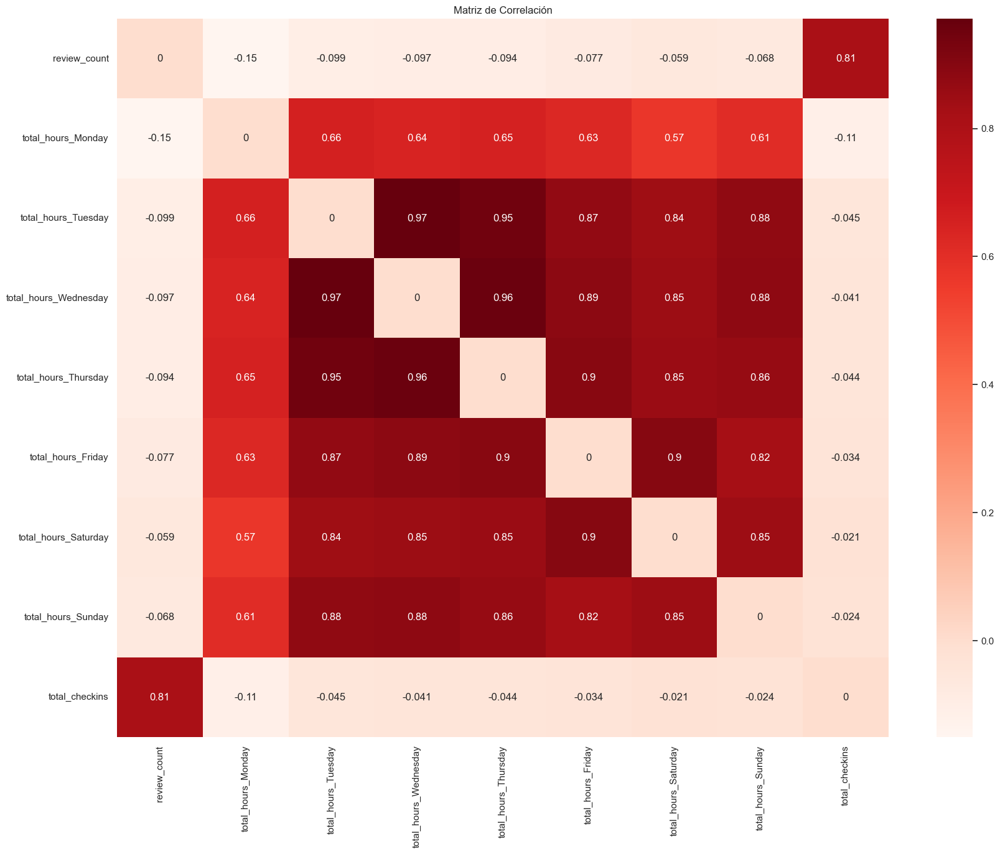

In [ ]:
# Display the correlation matrix of the 'num_var_df'. 

get_corr_matrix(dataset = num_var_df, metodo='pearson', size_figure=[20,15])

**Observamos como existe una fuerte correlación entre los horarios, principalmente porque son similiares durante los días de la semana. Además vemos como a cuanto mayor número de checkins de los usuarios mayor número de reviews que publican acerca del restaurante** 

## 3.5. Análisis de Outliers

En este apartado realizaremos un estudio de Outliers, es decir, detectar aquellos valores dentro de una muestra que no son consistentes con el resto.

In [39]:
# Obtain the outliers of the 'num_var_df' dataset.

outliers = get_outliers(num_var_df)

# Display number of rows withous NaN values.

print(outliers.count())

# Boxplot of the 'num_var_df' dataset.

fig = px.box(num_var_df, y=num_var_df.columns)
fig.show()



review_count             3368
total_hours_Monday          0
total_hours_Tuesday      1795
total_hours_Wednesday    1799
total_hours_Thursday     1836
total_hours_Friday       1682
total_hours_Saturday     1674
total_hours_Sunday       1783
total_checkins           3850
dtype: int64


**Observamos como las variables con mayor nº de outliers es `total_checkins` y `review_count`. Esto se puede deber a que la fama de algún restaurante sea mayor y provoque un aumento de las reviews, aunque también pueden ser opiniones compradas. Por lo que a la hora de realizar los modelos estudiaremos como trabajar con estos datos.**

# <a name="exportacion"> 4. Exportación del dataset transformado <a>


Procedemos a exportar el dataset que hemos ido transformando durante el EDA, para posteriormente en el paso de ingeniería de variables, dividirlo en Train, Validación y Test:

In [ ]:
# Export 'restaurants_df' as csv in the folder of processed data.

restaurants_df.to_parquet("../data/processed/restaurants_df.parquet")

[Ir arriba del documento](#top)